In [ ]:
# --- Kinematic Differential-drive semicircle animation ---
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, FFMpegWriter
from matplotlib.patches import Rectangle, Circle
from matplotlib.transforms import Affine2D
from IPython.display import Video, HTML
import math

# ---------- Parameters (change these to experiment) ----------
wheel_base = 0.6        # distance between wheel centers (m) (track)
body_length = 0.8       # body length (m) (front to back)
body_width  = wheel_base + 0.08  # body width (slightly bigger than track)
wheel_radius = 0.09     # wheel radius (m)
dt = 0.05               # simulation timestep (s)

# Semicircle path parameters (radius of curvature and robot turn rate)
R_c = 2.0               # radius of the semicircle path (m)
omega = 0.4             # angular rate around curvature center (rad/s)

# Derived wheel velocities that produce the chosen curvature:
# v_r = omega * (R_c + b/2), v_l = omega * (R_c - b/2)
v_r = omega * (R_c + wheel_base/2.0)
v_l = omega * (R_c - wheel_base/2.0)

# total time to sweep pi radians (a semicircle) and number of steps
T_total = math.pi / omega
steps = int(np.ceil(T_total / dt)) + 1

print(f"Computed wheel speeds for semicircle: v_left = {v_l:.4f} m/s, v_right = {v_r:.4f} m/s")
print(f"Total time ≈ {T_total:.2f} s, frames = {steps}")

# ---------- Simulate poses (unicycle integration) ----------
poses = np.zeros((steps, 3))   # columns x, y, theta
x = 0.0; y = 0.0; theta = 0.0  # initial pose (facing +x)
for i in range(steps):
    poses[i, :] = [x, y, theta]
    v = (v_r + v_l) / 2.0
    w = (v_r - v_l) / wheel_base
    x += v * math.cos(theta) * dt
    y += v * math.sin(theta) * dt
    theta += w * dt

# ---------- Set up plot limits so entire motion is visible ----------
xmin, xmax = poses[:,0].min(), poses[:,0].max()
ymin, ymax = poses[:,1].min(), poses[:,1].max()
pad = max(body_length, R_c) * 0.6 + 0.2
xlim = (xmin - pad, xmax + pad)
ylim = (ymin - pad, ymax + pad)

# ---------- Create figure and static elements ----------
fig, ax = plt.subplots(figsize=(7,7))
ax.set_aspect('equal', 'box')
ax.set_xlim(*xlim)
ax.set_ylim(*ylim)
ax.set_title("Differential-drive robot — semicircle motion")

# full planned path (faint dashed) and traveled path (colored)
ax.plot(poses[:,0], poses[:,1], linestyle='--', color='lightgray', label='planned path')
path_line, = ax.plot([], [], 'r-', lw=2, label='traveled path')

# A rectangle representing the body, constructed centered on origin in robot frame:
body = Rectangle((-body_length/2, -body_width/2), body_length, body_width,
                 edgecolor='tab:blue', facecolor='none', lw=2, zorder=4)
ax.add_patch(body)

# Wheels (initial positions will be set each frame)
wheel_left = Circle((0,  wheel_base/2), wheel_radius, color='k', zorder=5)
wheel_right= Circle((0, -wheel_base/2), wheel_radius, color='k', zorder=5)
ax.add_patch(wheel_left)
ax.add_patch(wheel_right)

# Text: velocities (top-left)
vel_text = ax.text(0.02, 0.98, '', transform=ax.transAxes, fontsize=11, va='top')

# Text boxes next to wheels to display their speeds (will move with wheels)
wheelL_label = ax.text(0,0,'', fontsize=9, va='center', ha='left',
                       bbox=dict(facecolor='white', alpha=0.7), zorder=6)
wheelR_label = ax.text(0,0,'', fontsize=9, va='center', ha='right',
                       bbox=dict(facecolor='white', alpha=0.7), zorder=6)

# Heading line (from robot center forward)
heading_line, = ax.plot([], [], color='g', lw=2, zorder=6)

# small helper to transform a point from robot frame (xr, yr) -> world
def robot_to_world(xr, yr, xw, yw, th):
    X = xw + xr * math.cos(th) - yr * math.sin(th)
    Y = yw + xr * math.sin(th) + yr * math.cos(th)
    return X, Y

# ---------- Animation functions ----------
def init():
    path_line.set_data([], [])
    vel_text.set_text('')
    heading_line.set_data([], [])
    # place static body at origin (transform will be updated in each frame)
    body.set_transform(Affine2D().translate(0,0) + ax.transData)
    wheel_left.center = robot_to_world(0, wheel_base/2, 0, 0, 0)
    wheel_right.center= robot_to_world(0, -wheel_base/2, 0, 0, 0)
    wheelL_label.set_position((0,0))
    wheelR_label.set_position((0,0))
    wheelL_label.set_text('')
    wheelR_label.set_text('')
    return path_line, body, wheel_left, wheel_right, heading_line, vel_text, wheelL_label, wheelR_label

def update(i):
    ax.set_xlabel("X position (m) [forward direction]")
    ax.set_ylabel("Y position (m) [lateral direction]")

    x, y, th = poses[i]
    # traveled path up to current frame
    path_line.set_data(poses[:i+1,0], poses[:i+1,1])

    # update body patch by rotating about origin then translating to (x,y)
    tr = Affine2D().rotate(th).translate(x, y) + ax.transData
    body.set_transform(tr)

    # update wheel centers (robot frame coordinates are (0, ±wheel_base/2))
    xL, yL = robot_to_world(0,  wheel_base/2, x, y, th)
    xR, yR = robot_to_world(0, -wheel_base/2, x, y, th)
    wheel_left.center = (xL, yL)
    wheel_right.center = (xR, yR)

    # heading line (small arrow-like line)
    head_len = body_length * 0.6
    hx, hy = x + head_len*math.cos(th), y + head_len*math.sin(th)
    heading_line.set_data([x, hx], [y, hy])

    # update velocity displays (instantaneous; for this semicircle v_l/v_r are constant,
    # but we still update them each frame so they appear "live")
    v = (v_r + v_l) / 2.0
    w = (v_r - v_l) / wheel_base
    vel_text.set_text(
        f"t = {i*dt:.2f} s\nv_left = {v_l:.3f} m/s\nv_right = {v_r:.3f} m/s\nv = {v:.3f} m/s\nomega = {w:.3f} rad/s"
    )

    # wheel labels next to each wheel
    # offset the label slightly outward from the wheel center (in world coords)
    off = 0.06
    # compute small outward offsets perpendicular to wheel line (use robot frame to pick a good offset)
    lx_off = xL + off * math.cos(th)  # a small offset forward
    ly_off = yL + off * math.sin(th)
    rx_off = xR + off * math.cos(th)
    ry_off = yR + off * math.sin(th)

    wheelL_label.set_position((lx_off, ly_off))
    wheelR_label.set_position((rx_off, ry_off))
    wheelL_label.set_text(f"{v_l:.3f} m/s")
    wheelR_label.set_text(f"{v_r:.3f} m/s")

    return path_line, body, wheel_left, wheel_right, heading_line, vel_text, wheelL_label, wheelR_label

# ---------- Make and save animation ----------
ani = FuncAnimation(fig, update, frames=len(poses), init_func=init,
                    blit=False, interval=dt*1000)

# Save as MP4 (fps = 1/dt)
fps = int(round(1.0 / dt))
writer = FFMpegWriter(fps=fps)
out_filename = "diff_drive_semicircle.mp4"
ani.save(out_filename, writer=writer)
plt.close(fig)  # close the static figure to avoid duplicate display

print(f"Saved video -> {out_filename}")

# Display the video inline in Colab
Video(out_filename, embed=True)
# Optional: directly download from Colab (uncomment to enable):
# from google.colab import files
# files.download(out_filename)


Computed wheel speeds for semicircle: v_left = 0.6800 m/s, v_right = 0.9200 m/s
Total time ≈ 7.85 s, frames = 159
Saved video -> diff_drive_semicircle.mp4


Computed wheel speeds for semicircle: v_left = 0.6800 m/s, v_right = 0.9200 m/s
Total time ≈ 7.85 s, frames = 159
Saved video -> diff_drive_semicircle.mp4
Saved plots -> kinematic_analysis_plots.png


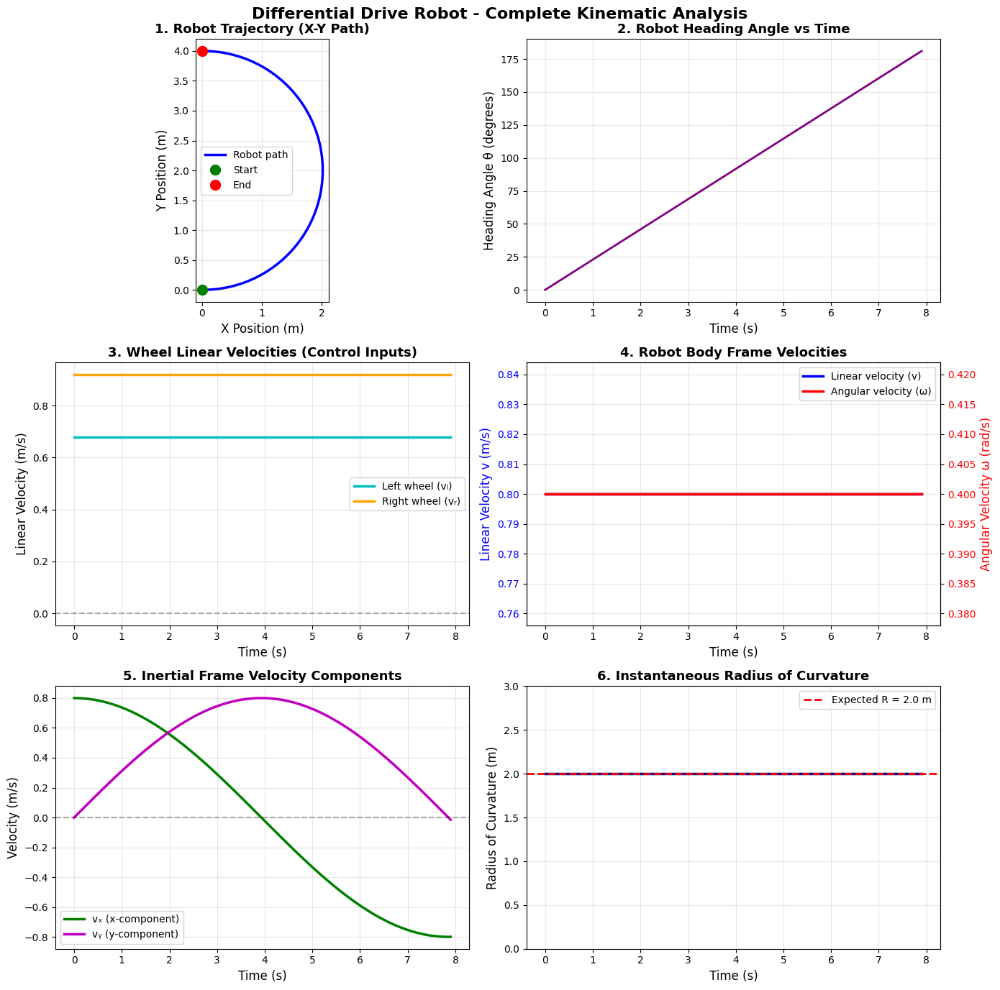

In [ ]:
# --- Kinematic Differential-drive semicircle animation with plots ---
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, FFMpegWriter
from matplotlib.patches import Rectangle, Circle
from matplotlib.transforms import Affine2D
from IPython.display import Video
import math

# ---------- Parameters (change these to experiment) ----------
wheel_base = 0.6        # distance between wheel centers (m) (track)
body_length = 0.8       # body length (m) (front to back)
body_width  = wheel_base + 0.08  # body width (slightly bigger than track)
wheel_radius = 0.09     # wheel radius (m)
dt = 0.05               # simulation timestep (s)

# Semicircle path parameters (radius of curvature and robot turn rate)
R_c = 2.0               # radius of the semicircle path (m)
omega = 0.4             # angular rate around curvature center (rad/s)

# Derived wheel velocities that produce the chosen curvature:
# v_r = omega * (R_c + b/2), v_l = omega * (R_c - b/2)
v_r = omega * (R_c + wheel_base/2.0)
v_l = omega * (R_c - wheel_base/2.0)

# total time to sweep pi radians (a semicircle) and number of steps
T_total = math.pi / omega
steps = int(np.ceil(T_total / dt)) + 1

print(f"Computed wheel speeds for semicircle: v_left = {v_l:.4f} m/s, v_right = {v_r:.4f} m/s")
print(f"Total time ≈ {T_total:.2f} s, frames = {steps}")

# ---------- Simulate poses and velocities ----------
poses = np.zeros((steps, 3))   # columns x, y, theta
# Store velocities for plotting
v_body = np.zeros(steps)       # body frame forward velocity
omega_body = np.zeros(steps)   # body frame angular velocity
v_x_inertial = np.zeros(steps) # x-component in inertial frame
v_y_inertial = np.zeros(steps) # y-component in inertial frame
omega_l = np.zeros(steps)      # left wheel angular velocity (rad/s)
omega_r = np.zeros(steps)      # right wheel angular velocity (rad/s)
v_l_linear = np.zeros(steps)   # left wheel linear velocity (m/s)
v_r_linear = np.zeros(steps)   # right wheel linear velocity (m/s)
time_array = np.zeros(steps)   # time array for plotting

x = 0.0; y = 0.0; theta = 0.0  # initial pose (facing +x)
for i in range(steps):
    poses[i, :] = [x, y, theta]
    time_array[i] = i * dt

    # Compute velocities
    v = (v_r + v_l) / 2.0
    w = (v_r - v_l) / wheel_base

    # Body frame velocity
    v_body[i] = v
    omega_body[i] = w

    # Inertial frame velocity components
    v_x_inertial[i] = v * math.cos(theta)
    v_y_inertial[i] = v * math.sin(theta)

    # Wheel angular velocities (omega = v / r)
    omega_l[i] = v_l / wheel_radius
    omega_r[i] = v_r / wheel_radius

    # Wheel linear velocities
    v_l_linear[i] = v_l
    v_r_linear[i] = v_r

    # Update pose
    x += v * math.cos(theta) * dt
    y += v * math.sin(theta) * dt
    theta += w * dt

# ---------- Set up plot limits so entire motion is visible ----------
xmin, xmax = poses[:,0].min(), poses[:,0].max()
ymin, ymax = poses[:,1].min(), poses[:,1].max()
pad = max(body_length, R_c) * 0.6 + 0.2
xlim = (xmin - pad, xmax + pad)
ylim = (ymin - pad, ymax + pad)

# ---------- Create figure and static elements ----------
fig, ax = plt.subplots(figsize=(7,7))
ax.set_aspect('equal', 'box')
ax.set_xlim(*xlim)
ax.set_ylim(*ylim)
ax.set_title("Differential-drive robot — semicircle motion")

# full planned path (faint dashed) and traveled path (colored)
ax.plot(poses[:,0], poses[:,1], linestyle='--', color='lightgray', label='planned path')
path_line, = ax.plot([], [], 'r-', lw=2, label='traveled path')

# A rectangle representing the body, constructed centered on origin in robot frame:
body = Rectangle((-body_length/2, -body_width/2), body_length, body_width,
                 edgecolor='tab:blue', facecolor='none', lw=2, zorder=4)
ax.add_patch(body)

# Wheels (initial positions will be set each frame)
wheel_left = Circle((0,  wheel_base/2), wheel_radius, color='k', zorder=5)
wheel_right= Circle((0, -wheel_base/2), wheel_radius, color='k', zorder=5)
ax.add_patch(wheel_left)
ax.add_patch(wheel_right)

# Text: velocities (top-left)
vel_text = ax.text(0.02, 0.98, '', transform=ax.transAxes, fontsize=11, va='top')

# Text boxes next to wheels to display their speeds (will move with wheels)
wheelL_label = ax.text(0,0,'', fontsize=9, va='center', ha='left',
                       bbox=dict(facecolor='white', alpha=0.7), zorder=6)
wheelR_label = ax.text(0,0,'', fontsize=9, va='center', ha='right',
                       bbox=dict(facecolor='white', alpha=0.7), zorder=6)

# Heading line (from robot center forward)
heading_line, = ax.plot([], [], color='g', lw=2, zorder=6)

# small helper to transform a point from robot frame (xr, yr) -> world
def robot_to_world(xr, yr, xw, yw, th):
    X = xw + xr * math.cos(th) - yr * math.sin(th)
    Y = yw + xr * math.sin(th) + yr * math.cos(th)
    return X, Y

# ---------- Animation functions ----------
def init():
    path_line.set_data([], [])
    vel_text.set_text('')
    heading_line.set_data([], [])
    body.set_transform(Affine2D().translate(0,0) + ax.transData)
    wheel_left.center = robot_to_world(0, wheel_base/2, 0, 0, 0)
    wheel_right.center= robot_to_world(0, -wheel_base/2, 0, 0, 0)
    wheelL_label.set_position((0,0))
    wheelR_label.set_position((0,0))
    wheelL_label.set_text('')
    wheelR_label.set_text('')
    return path_line, body, wheel_left, wheel_right, heading_line, vel_text, wheelL_label, wheelR_label

def update(i):
    ax.set_xlabel("X position (m) [forward direction]")
    ax.set_ylabel("Y position (m) [lateral direction]")

    x, y, th = poses[i]
    path_line.set_data(poses[:i+1,0], poses[:i+1,1])

    tr = Affine2D().rotate(th).translate(x, y) + ax.transData
    body.set_transform(tr)

    xL, yL = robot_to_world(0,  wheel_base/2, x, y, th)
    xR, yR = robot_to_world(0, -wheel_base/2, x, y, th)
    wheel_left.center = (xL, yL)
    wheel_right.center = (xR, yR)

    head_len = body_length * 0.6
    hx, hy = x + head_len*math.cos(th), y + head_len*math.sin(th)
    heading_line.set_data([x, hx], [y, hy])

    v = (v_r + v_l) / 2.0
    w = (v_r - v_l) / wheel_base
    vel_text.set_text(
        f"t = {i*dt:.2f} s\nv_left = {v_l:.3f} m/s\nv_right = {v_r:.3f} m/s\nv = {v:.3f} m/s\nomega = {w:.3f} rad/s"
    )

    off = 0.06
    lx_off = xL + off * math.cos(th)
    ly_off = yL + off * math.sin(th)
    rx_off = xR + off * math.cos(th)
    ry_off = yR + off * math.sin(th)

    wheelL_label.set_position((lx_off, ly_off))
    wheelR_label.set_position((rx_off, ry_off))
    wheelL_label.set_text(f"{v_l:.3f} m/s")
    wheelR_label.set_text(f"{v_r:.3f} m/s")

    return path_line, body, wheel_left, wheel_right, heading_line, vel_text, wheelL_label, wheelR_label

# ---------- Make and save animation ----------
ani = FuncAnimation(fig, update, frames=len(poses), init_func=init,
                    blit=False, interval=dt*1000)

fps = int(round(1.0 / dt))
writer = FFMpegWriter(fps=fps)
out_filename = "diff_drive_semicircle.mp4"
ani.save(out_filename, writer=writer)
plt.close(fig)

print(f"Saved video -> {out_filename}")

# ---------- Create comprehensive kinematic plots ----------
fig2, axes = plt.subplots(3, 2, figsize=(14, 14))
fig2.suptitle('Differential Drive Robot - Complete Kinematic Analysis', fontsize=16, fontweight='bold')

# Plot 1: Trajectory (X-Y path)
axes[0, 0].plot(poses[:,0], poses[:,1], 'b-', linewidth=2.5, label='Robot path')
axes[0, 0].plot(poses[0,0], poses[0,1], 'go', markersize=10, label='Start')
axes[0, 0].plot(poses[-1,0], poses[-1,1], 'ro', markersize=10, label='End')
axes[0, 0].set_xlabel('X Position (m)', fontsize=12)
axes[0, 0].set_ylabel('Y Position (m)', fontsize=12)
axes[0, 0].set_title('1. Robot Trajectory (X-Y Path)', fontsize=13, fontweight='bold')
axes[0, 0].legend(loc='best', fontsize=10)
axes[0, 0].grid(True, alpha=0.3)
axes[0, 0].set_aspect('equal', 'box')

# Plot 2: Heading angle (theta) vs time
axes[0, 1].plot(time_array, np.rad2deg(poses[:,2]), 'purple', linewidth=2)
axes[0, 1].set_xlabel('Time (s)', fontsize=12)
axes[0, 1].set_ylabel('Heading Angle θ (degrees)', fontsize=12)
axes[0, 1].set_title('2. Robot Heading Angle vs Time', fontsize=13, fontweight='bold')
axes[0, 1].grid(True, alpha=0.3)

# Plot 3: Wheel Linear Velocities
axes[1, 0].plot(time_array, v_l_linear, 'c-', linewidth=2.5, label='Left wheel (vₗ)')
axes[1, 0].plot(time_array, v_r_linear, 'orange', linewidth=2.5, label='Right wheel (vᵣ)')
axes[1, 0].axhline(y=0, color='k', linestyle='--', alpha=0.3)
axes[1, 0].set_xlabel('Time (s)', fontsize=12)
axes[1, 0].set_ylabel('Linear Velocity (m/s)', fontsize=12)
axes[1, 0].set_title('3. Wheel Linear Velocities (Control Inputs)', fontsize=13, fontweight='bold')
axes[1, 0].legend(loc='best', fontsize=10)
axes[1, 0].grid(True, alpha=0.3)

# Plot 4: Robot Body Frame Velocities
ax4_1 = axes[1, 1]
ax4_2 = ax4_1.twinx()
line1 = ax4_1.plot(time_array, v_body, 'b-', linewidth=2.5, label='Linear velocity (v)')
line2 = ax4_2.plot(time_array, omega_body, 'r-', linewidth=2.5, label='Angular velocity (ω)')
ax4_1.set_xlabel('Time (s)', fontsize=12)
ax4_1.set_ylabel('Linear Velocity v (m/s)', fontsize=12, color='b')
ax4_2.set_ylabel('Angular Velocity ω (rad/s)', fontsize=12, color='r')
ax4_1.set_title('4. Robot Body Frame Velocities', fontsize=13, fontweight='bold')
ax4_1.tick_params(axis='y', labelcolor='b')
ax4_2.tick_params(axis='y', labelcolor='r')
lines = line1 + line2
labels = [l.get_label() for l in lines]
ax4_1.legend(lines, labels, loc='best', fontsize=10)
ax4_1.grid(True, alpha=0.3)

# Plot 5: Velocity Components in Inertial Frame
axes[2, 0].plot(time_array, v_x_inertial, 'g-', linewidth=2.5, label='vₓ (x-component)')
axes[2, 0].plot(time_array, v_y_inertial, 'm-', linewidth=2.5, label='vᵧ (y-component)')
axes[2, 0].axhline(y=0, color='k', linestyle='--', alpha=0.3)
axes[2, 0].set_xlabel('Time (s)', fontsize=12)
axes[2, 0].set_ylabel('Velocity (m/s)', fontsize=12)
axes[2, 0].set_title('5. Inertial Frame Velocity Components', fontsize=13, fontweight='bold')
axes[2, 0].legend(loc='best', fontsize=10)
axes[2, 0].grid(True, alpha=0.3)

# Plot 6: Instantaneous Center of Curvature (ICC) Distance
# For differential drive: ICC distance from robot center = R = v/ω
R_icc = np.where(np.abs(omega_body) > 1e-6, v_body / omega_body, np.inf)
R_icc = np.clip(R_icc, -10, 10)  # Clip for visualization
axes[2, 1].plot(time_array, R_icc, 'darkblue', linewidth=2.5)
axes[2, 1].axhline(y=R_c, color='r', linestyle='--', linewidth=2, label=f'Expected R = {R_c} m')
axes[2, 1].set_xlabel('Time (s)', fontsize=12)
axes[2, 1].set_ylabel('Radius of Curvature (m)', fontsize=12)
axes[2, 1].set_title('6. Instantaneous Radius of Curvature', fontsize=13, fontweight='bold')
axes[2, 1].legend(loc='best', fontsize=10)
axes[2, 1].grid(True, alpha=0.3)
axes[2, 1].set_ylim([0, R_c * 1.5])

plt.tight_layout()
plot_filename = "kinematic_analysis_plots.png"
plt.savefig(plot_filename, dpi=300, bbox_inches='tight')
print(f"Saved plots -> {plot_filename}")
plt.show()

# Display the video inline in Colab
Video(out_filename, embed=True)

In [ ]:
# --- Differential-drive straight-line animation (Google Colab) ---
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, FFMpegWriter
from matplotlib.patches import Rectangle, Circle
from matplotlib.transforms import Affine2D
from IPython.display import Video
import math

# ---------- Parameters ----------
wheel_base = 0.6        # distance between wheel centers (m)
body_length = 0.8       # robot body length
body_width  = wheel_base + 0.08
wheel_radius = 0.09
dt = 0.05               # timestep

# Straight line parameters
v_forward = 0.5         # forward speed (m/s)
T_total = 8.0           # total time (s)
steps = int(np.ceil(T_total / dt)) + 1

# Equal wheel speeds for straight line
v_r = v_forward
v_l = v_forward

print(f"Straight line motion: v_left = {v_l:.3f} m/s, v_right = {v_r:.3f} m/s")

# ---------- Simulate poses ----------
poses = np.zeros((steps, 3))   # x, y, theta
x, y, theta = 0.0, 0.0, 0.0    # start at origin, facing +x
for i in range(steps):
    poses[i, :] = [x, y, theta]
    v = (v_r + v_l) / 2.0
    w = (v_r - v_l) / wheel_base
    x += v * math.cos(theta) * dt
    y += v * math.sin(theta) * dt
    theta += w * dt

# ---------- Plot limits ----------
xmin, xmax = poses[:,0].min(), poses[:,0].max()
ymin, ymax = poses[:,1].min(), poses[:,1].max()
pad = body_length * 0.8
xlim = (xmin - pad, xmax + pad)
ylim = (ymin - pad, ymax + pad)

# ---------- Figure setup ----------
fig, ax = plt.subplots(figsize=(7,4))
ax.set_aspect('equal', 'box')
ax.set_xlim(*xlim)
ax.set_ylim(*ylim)
ax.set_title("Differential-drive robot — straight line motion")

# Full path and live path
ax.plot(poses[:,0], poses[:,1], linestyle='--', color='lightgray', label='planned path')
path_line, = ax.plot([], [], 'r-', lw=2, label='traveled path')

# Robot body rectangle
body = Rectangle((-body_length/2, -body_width/2), body_length, body_width,
                 edgecolor='tab:blue', facecolor='none', lw=2, zorder=4)
ax.add_patch(body)

# Wheels
wheel_left = Circle((0,  wheel_base/2), wheel_radius, color='k', zorder=5)
wheel_right= Circle((0, -wheel_base/2), wheel_radius, color='k', zorder=5)
ax.add_patch(wheel_left)
ax.add_patch(wheel_right)

# Text: velocities
vel_text = ax.text(0.02, 0.98, '', transform=ax.transAxes, fontsize=11, va='top')

# Labels near wheels
wheelL_label = ax.text(0,0,'', fontsize=9, va='center', ha='left',
                       bbox=dict(facecolor='white', alpha=0.7), zorder=6)
wheelR_label = ax.text(0,0,'', fontsize=9, va='center', ha='right',
                       bbox=dict(facecolor='white', alpha=0.7), zorder=6)

# Heading line
heading_line, = ax.plot([], [], color='g', lw=2, zorder=6)

def robot_to_world(xr, yr, xw, yw, th):
    X = xw + xr * math.cos(th) - yr * math.sin(th)
    Y = yw + xr * math.sin(th) + yr * math.cos(th)
    return X, Y

def init():
    path_line.set_data([], [])
    vel_text.set_text('')
    heading_line.set_data([], [])
    body.set_transform(Affine2D().translate(0,0) + ax.transData)
    return path_line, body, wheel_left, wheel_right, heading_line, vel_text, wheelL_label, wheelR_label

def update(i):
    ax.set_xlabel("X position (m) [forward direction]")
    ax.set_ylabel("Y position (m) [lateral direction]")

    x, y, th = poses[i]
    path_line.set_data(poses[:i+1,0], poses[:i+1,1])

    # update body transform
    tr = Affine2D().rotate(th).translate(x, y) + ax.transData
    body.set_transform(tr)

    # wheel centers
    xL, yL = robot_to_world(0,  wheel_base/2, x, y, th)
    xR, yR = robot_to_world(0, -wheel_base/2, x, y, th)
    wheel_left.center = (xL, yL)
    wheel_right.center = (xR, yR)

    # heading line
    head_len = body_length * 0.6
    hx, hy = x + head_len*math.cos(th), y + head_len*math.sin(th)
    heading_line.set_data([x, hx], [y, hy])

    # update text (live display)
    vel_text.set_text(f"t = {i*dt:.2f} s\nv_left = {v_l:.3f} m/s\nv_right = {v_r:.3f} m/s")

    wheelL_label.set_position((xL+0.1, yL))
    wheelR_label.set_position((xR-0.1, yR))
    wheelL_label.set_text(f"{v_l:.3f} m/s")
    wheelR_label.set_text(f"{v_r:.3f} m/s")

    return path_line, body, wheel_left, wheel_right, heading_line, vel_text, wheelL_label, wheelR_label

ani = FuncAnimation(fig, update, frames=len(poses), init_func=init,
                    blit=False, interval=dt*1000)

# Save video
fps = int(round(1.0/dt))
writer = FFMpegWriter(fps=fps)
out_filename = "diff_drive_straight.mp4"
ani.save(out_filename, writer=writer)
plt.close(fig)

print(f"✅ Saved video -> {out_filename}")
Video(out_filename, embed=True)


Straight line motion: v_left = 0.500 m/s, v_right = 0.500 m/s
✅ Saved video -> diff_drive_straight.mp4


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, FFMpegWriter
from matplotlib import transforms

# Robot parameters
L = 0.6   # wheel separation
W = 0.4   # body width
dt = 0.05 # timestep
v_wheel = 0.5  # wheel speed (m/s)

# Wheel velocities (right spin turn)
v_r = -v_wheel
v_l = +v_wheel

# Angular velocity about robot center
omega = (v_r - v_l)/L

print("Right wheel velocity:", round(v_r,3), "m/s")
print("Left wheel velocity:", round(v_l,3), "m/s")
print("Angular velocity:", round(omega,3), "rad/s")

# Initial pose
x, y, theta = 0.0, 0.0, 0.0
poses = [(x,y,theta)]

# Simulate one full rotation
steps = int((2*np.pi) / (abs(omega)*dt))
for _ in range(steps):
    theta += omega*dt
    poses.append((x,y,theta))
poses = np.array(poses)

# --- Animation ---
fig, ax = plt.subplots()
ax.set_aspect('equal')
ax.set_xlim(-2, 2)
ax.set_ylim(-2, 2)
ax.set_title("Differential Drive Robot - In Place Right Spin")
ax.set_xlabel("X position (m) [forward direction]")
ax.set_ylabel("Y position (m) [lateral direction]")

# Draw global X and Y axis arrows
ax.arrow(0, 0, 1, 0, head_width=0.1, head_length=0.1, fc='k', ec='k')
ax.text(1.1, 0, 'X', fontsize=12)
ax.arrow(0, 0, 0, 1, head_width=0.1, head_length=0.1, fc='k', ec='k')
ax.text(0, 1.1, 'Y', fontsize=12)

# Robot body (rectangle centered at origin first)
body = plt.Rectangle((-W/2, -L/2), W, L, fill=False, color='b', lw=2)
ax.add_patch(body)

# Wheels
wheel_left = plt.Circle((0,0), 0.08, color='k')
wheel_right = plt.Circle((0,0), 0.08, color='k')
ax.add_patch(wheel_left)
ax.add_patch(wheel_right)

# Text for velocities
vel_text = ax.text(0.02, 0.95, '', transform=ax.transAxes)

def init():
    vel_text.set_text('')
    return body, wheel_left, wheel_right, vel_text

def update(frame):
    x, y, theta = poses[frame]

    # Transformation for body: rotate then translate
    tr = transforms.Affine2D().rotate(theta).translate(x, y) + ax.transData
    body.set_transform(tr)

    # Update wheels (at left/right of center)
    x_left  = x - (L/2)*np.sin(theta)
    y_left  = y + (L/2)*np.cos(theta)
    x_right = x + (L/2)*np.sin(theta)
    y_right = y - (L/2)*np.cos(theta)
    wheel_left.center = (x_left, y_left)
    wheel_right.center = (x_right, y_right)

    # Update velocity text
    vel_text.set_text(f"v_left = {v_l:.2f} m/s\nv_right = {v_r:.2f} m/s")

    return body, wheel_left, wheel_right, vel_text

ani = FuncAnimation(fig, update, frames=len(poses),
                    init_func=init, blit=False, interval=50)

# Save video
writer = FFMpegWriter(fps=20)
ani.save("diff_drive_inplace_spin.mp4", writer=writer)
plt.close(fig)

print("✅ Animation saved as diff_drive_inplace_spin.mp4")


Right wheel velocity: -0.5 m/s
Left wheel velocity: 0.5 m/s
Angular velocity: -1.667 rad/s
✅ Animation saved as diff_drive_inplace_spin.mp4


In [ ]:
from IPython.display import Video
Video("diff_drive_inplace_spin.mp4", embed=True)


Right wheel velocity: -0.5 m/s
Left wheel velocity: 0.5 m/s
Angular velocity: -1.667 rad/s
✅ Animation saved as diff_drive_inplace_spin.mp4
✅ Saved plots -> inplace_rotation_analysis.png


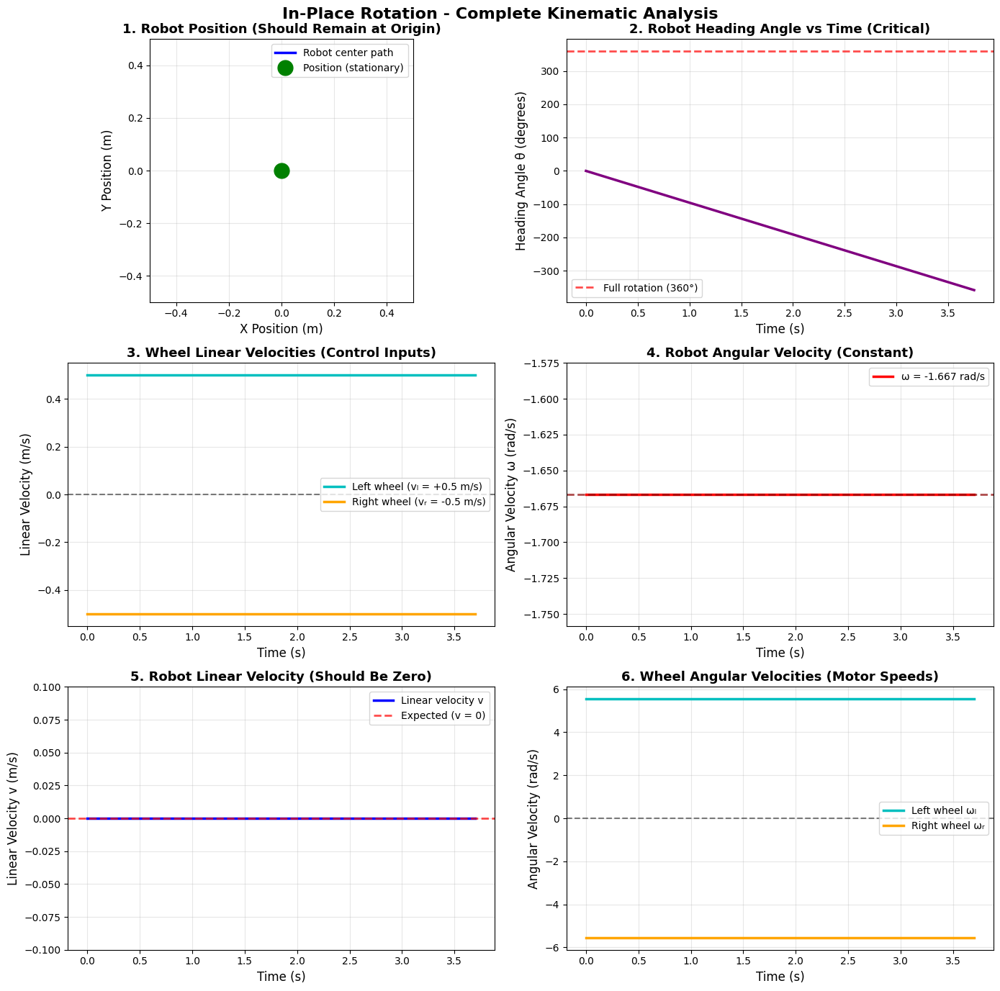

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, FFMpegWriter
from matplotlib import transforms
from IPython.display import Video

# Robot parameters
L = 0.6   # wheel separation
W = 0.4   # body width
dt = 0.05 # timestep
v_wheel = 0.5  # wheel speed (m/s)
wheel_radius = 0.09  # wheel radius (m)

# Wheel velocities (right spin turn)
v_r = -v_wheel
v_l = +v_wheel

# Angular velocity about robot center
omega = (v_r - v_l)/L

print("Right wheel velocity:", round(v_r,3), "m/s")
print("Left wheel velocity:", round(v_l,3), "m/s")
print("Angular velocity:", round(omega,3), "rad/s")

# Initial pose
x, y, theta = 0.0, 0.0, 0.0
poses = [(x,y,theta)]

# Arrays to store kinematic data
time_array = [0]
v_body_array = []
omega_body_array = []
v_x_inertial = []
v_y_inertial = []
v_l_array = []
v_r_array = []
omega_l_array = []
omega_r_array = []
theta_array = [0]

# Simulate one full rotation
steps = int((2*np.pi) / (abs(omega)*dt))
for i in range(steps):
    # Store velocities
    v_body = (v_r + v_l) / 2.0  # For in-place rotation, this is 0
    omega_body_array.append(omega)
    v_body_array.append(v_body)

    # Inertial frame velocities (position doesn't change, so both are 0)
    v_x_inertial.append(v_body * np.cos(theta))
    v_y_inertial.append(v_body * np.sin(theta))

    # Wheel velocities
    v_l_array.append(v_l)
    v_r_array.append(v_r)

    # Wheel angular velocities
    omega_l_array.append(v_l / wheel_radius)
    omega_r_array.append(v_r / wheel_radius)

    # Update pose
    theta += omega*dt
    time_array.append((i+1)*dt)
    theta_array.append(theta)
    poses.append((x,y,theta))

poses = np.array(poses)
time_array = np.array(time_array)
v_body_array = np.array(v_body_array)
omega_body_array = np.array(omega_body_array)
v_x_inertial = np.array(v_x_inertial)
v_y_inertial = np.array(v_y_inertial)
v_l_array = np.array(v_l_array)
v_r_array = np.array(v_r_array)
omega_l_array = np.array(omega_l_array)
omega_r_array = np.array(omega_r_array)
theta_array = np.array(theta_array)

# --- Animation ---
fig, ax = plt.subplots(figsize=(7,7))
ax.set_aspect('equal')
ax.set_xlim(-2, 2)
ax.set_ylim(-2, 2)
ax.set_title("Differential Drive Robot - In Place Right Spin")
ax.set_xlabel("X position (m) [forward direction]")
ax.set_ylabel("Y position (m) [lateral direction]")

# Draw global X and Y axis arrows
ax.arrow(0, 0, 1, 0, head_width=0.1, head_length=0.1, fc='k', ec='k')
ax.text(1.1, 0, 'X', fontsize=12)
ax.arrow(0, 0, 0, 1, head_width=0.1, head_length=0.1, fc='k', ec='k')
ax.text(0, 1.1, 'Y', fontsize=12)

# Robot body (rectangle centered at origin first)
body = plt.Rectangle((-W/2, -L/2), W, L, fill=False, color='b', lw=2)
ax.add_patch(body)

# Wheels
wheel_left = plt.Circle((0,0), 0.08, color='k')
wheel_right = plt.Circle((0,0), 0.08, color='k')
ax.add_patch(wheel_left)
ax.add_patch(wheel_right)

# Heading line
heading_line, = ax.plot([], [], 'g-', lw=2)

# Text for velocities
vel_text = ax.text(0.02, 0.95, '', transform=ax.transAxes, fontsize=11, va='top')

def init():
    vel_text.set_text('')
    heading_line.set_data([], [])
    return body, wheel_left, wheel_right, vel_text, heading_line

def update(frame):
    x, y, theta = poses[frame]

    # Transformation for body: rotate then translate
    tr = transforms.Affine2D().rotate(theta).translate(x, y) + ax.transData
    body.set_transform(tr)

    # Update wheels (at left/right of center)
    x_left  = x - (L/2)*np.sin(theta)
    y_left  = y + (L/2)*np.cos(theta)
    x_right = x + (L/2)*np.sin(theta)
    y_right = y - (L/2)*np.cos(theta)
    wheel_left.center = (x_left, y_left)
    wheel_right.center = (x_right, y_right)

    # Heading line
    head_len = W * 1.2
    hx, hy = x + head_len*np.cos(theta), y + head_len*np.sin(theta)
    heading_line.set_data([x, hx], [y, hy])

    # Update velocity text
    vel_text.set_text(
        f"t = {time_array[frame]:.2f} s\n"
        f"v_left = {v_l:.2f} m/s\n"
        f"v_right = {v_r:.2f} m/s\n"
        f"θ = {np.rad2deg(theta):.1f}°\n"
        f"ω = {omega:.3f} rad/s"
    )

    return body, wheel_left, wheel_right, vel_text, heading_line

ani = FuncAnimation(fig, update, frames=len(poses),
                    init_func=init, blit=False, interval=50)

# Save video
writer = FFMpegWriter(fps=20)
out_filename = "diff_drive_inplace_spin.mp4"
ani.save(out_filename, writer=writer)
plt.close(fig)

print(f"✅ Animation saved as {out_filename}")

# ---------- Create comprehensive kinematic plots for IN-PLACE ROTATION ----------
fig2, axes = plt.subplots(3, 2, figsize=(14, 14))
fig2.suptitle('In-Place Rotation - Complete Kinematic Analysis', fontsize=16, fontweight='bold')

# Plot 1: Position Trajectory (should show robot stays at origin)
axes[0, 0].plot(poses[:,0], poses[:,1], 'b-', linewidth=2.5, label='Robot center path')
axes[0, 0].plot(poses[0,0], poses[0,1], 'go', markersize=15, label='Position (stationary)', zorder=5)
axes[0, 0].set_xlabel('X Position (m)', fontsize=12)
axes[0, 0].set_ylabel('Y Position (m)', fontsize=12)
axes[0, 0].set_title('1. Robot Position (Should Remain at Origin)', fontsize=13, fontweight='bold')
axes[0, 0].legend(loc='best', fontsize=10)
axes[0, 0].grid(True, alpha=0.3)
axes[0, 0].set_aspect('equal', 'box')
axes[0, 0].set_xlim(-0.5, 0.5)
axes[0, 0].set_ylim(-0.5, 0.5)

# Plot 2: Heading angle (theta) vs time - MOST IMPORTANT for rotation
axes[0, 1].plot(time_array, np.rad2deg(theta_array), 'purple', linewidth=2.5)
axes[0, 1].axhline(y=360, color='r', linestyle='--', linewidth=2, alpha=0.7, label='Full rotation (360°)')
axes[0, 1].set_xlabel('Time (s)', fontsize=12)
axes[0, 1].set_ylabel('Heading Angle θ (degrees)', fontsize=12)
axes[0, 1].set_title('2. Robot Heading Angle vs Time (Critical)', fontsize=13, fontweight='bold')
axes[0, 1].legend(loc='best', fontsize=10)
axes[0, 1].grid(True, alpha=0.3)

# Plot 3: Wheel Linear Velocities - CONTROL INPUTS
axes[1, 0].plot(time_array[:-1], v_l_array, 'c-', linewidth=2.5, label='Left wheel (vₗ = +0.5 m/s)')
axes[1, 0].plot(time_array[:-1], v_r_array, 'orange', linewidth=2.5, label='Right wheel (vᵣ = -0.5 m/s)')
axes[1, 0].axhline(y=0, color='k', linestyle='--', alpha=0.5)
axes[1, 0].set_xlabel('Time (s)', fontsize=12)
axes[1, 0].set_ylabel('Linear Velocity (m/s)', fontsize=12)
axes[1, 0].set_title('3. Wheel Linear Velocities (Control Inputs)', fontsize=13, fontweight='bold')
axes[1, 0].legend(loc='best', fontsize=10)
axes[1, 0].grid(True, alpha=0.3)

# Plot 4: Angular Velocity - KEY METRIC for rotation
axes[1, 1].plot(time_array[:-1], omega_body_array, 'r-', linewidth=2.5, label=f'ω = {omega:.3f} rad/s')
axes[1, 1].axhline(y=omega, color='darkred', linestyle='--', linewidth=2, alpha=0.7)
axes[1, 1].set_xlabel('Time (s)', fontsize=12)
axes[1, 1].set_ylabel('Angular Velocity ω (rad/s)', fontsize=12)
axes[1, 1].set_title('4. Robot Angular Velocity (Constant)', fontsize=13, fontweight='bold')
axes[1, 1].legend(loc='best', fontsize=10)
axes[1, 1].grid(True, alpha=0.3)

# Plot 5: Linear Velocity (should be zero for in-place rotation)
axes[2, 0].plot(time_array[:-1], v_body_array, 'b-', linewidth=2.5, label='Linear velocity v')
axes[2, 0].axhline(y=0, color='r', linestyle='--', linewidth=2, alpha=0.7, label='Expected (v = 0)')
axes[2, 0].set_xlabel('Time (s)', fontsize=12)
axes[2, 0].set_ylabel('Linear Velocity v (m/s)', fontsize=12)
axes[2, 0].set_title('5. Robot Linear Velocity (Should Be Zero)', fontsize=13, fontweight='bold')
axes[2, 0].legend(loc='best', fontsize=10)
axes[2, 0].grid(True, alpha=0.3)
axes[2, 0].set_ylim(-0.1, 0.1)

# Plot 6: Wheel Angular Velocities (motor speeds)
axes[2, 1].plot(time_array[:-1], omega_l_array, 'c-', linewidth=2.5, label=f'Left wheel ωₗ')
axes[2, 1].plot(time_array[:-1], omega_r_array, 'orange', linewidth=2.5, label=f'Right wheel ωᵣ')
axes[2, 1].axhline(y=0, color='k', linestyle='--', alpha=0.5)
axes[2, 1].set_xlabel('Time (s)', fontsize=12)
axes[2, 1].set_ylabel('Angular Velocity (rad/s)', fontsize=12)
axes[2, 1].set_title('6. Wheel Angular Velocities (Motor Speeds)', fontsize=13, fontweight='bold')
axes[2, 1].legend(loc='best', fontsize=10)
axes[2, 1].grid(True, alpha=0.3)

plt.tight_layout()
plot_filename = "inplace_rotation_analysis.png"
plt.savefig(plot_filename, dpi=300, bbox_inches='tight')
print(f"✅ Saved plots -> {plot_filename}")
plt.show()

# Display the video
Video(out_filename, embed=True)

## DYNAMIC SIMULATIONS OF STRAIGHT LINE MOTION


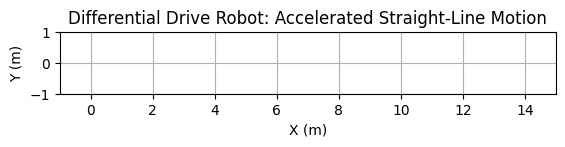

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# --- Robot Parameters ---
R = 0.1  # Wheel radius (m)
L = 0.4  # Distance between wheels (m)

# --- Dynamic & Simulation Parameters ---
a = 0.2  # Constant linear acceleration (m/s^2)
dt = 0.01  # Time step (s)
T_total = 15  # Total simulation time (s)
num_steps = int(T_total / dt)

# --- Initial State ---
x = 0
y = 0
theta = 0
v = 0  # Initial velocity is zero

# --- Create a figure and axes for the plot ---
fig, ax = plt.subplots()
ax.set_aspect('equal')
ax.set_xlim(-1, 15)
ax.set_ylim(-1, 1)
ax.set_xlabel('X (m)')
ax.set_ylabel('Y (m)')
ax.set_title('Differential Drive Robot: Accelerated Straight-Line Motion')
ax.grid(True)

# --- Initialize robot parts ---
# Body (rectangle)
rect = plt.Rectangle((0, 0), L, L*0.5, fc='blue', ec='black', zorder=2)
ax.add_patch(rect)
# Wheels (circles)
wheel_l = plt.Circle((0, 0), R, fc='black', zorder=3)
wheel_r = plt.Circle((0, 0), R, fc='black', zorder=3)
ax.add_patch(wheel_l)
ax.add_patch(wheel_r)

# --- Update function for the animation ---
def update(frame):
    global x, y, theta, v

    # Update velocity with constant acceleration
    v += a * dt

    # Update state based on the current velocity
    x += v * np.cos(theta) * dt
    y += v * np.sin(theta) * dt
    # For straight-line motion, theta remains constant

    # Update the position of the body and wheels
    rect.set_x(x - L/2)
    rect.set_y(y - L*0.25)

    wheel_l.center = (x - L/2 + R, y - L*0.25 - 0.05)
    wheel_r.center = (x - L/2 + R, y + L*0.25 + 0.05)

    # You would need a more sophisticated model to make the wheels appear to roll
    # This example focuses on the acceleration of the overall body.

    return rect, wheel_l, wheel_r

# --- Create the animation ---
ani = FuncAnimation(fig, update, frames=num_steps, blit=True)

# --- To display the animation in Google Colab ---
from IPython.display import HTML
HTML(ani.to_jshtml())

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, FFMpegWriter
from matplotlib.patches import Rectangle, Circle
from matplotlib.transforms import Affine2D
from IPython.display import Video

# --- Robot Parameters ---
R = 0.1  # Wheel radius (m)
L = 0.4  # Distance between wheels (m)
m = 10.0  # Robot mass (kg)
I = 0.5  # Robot moment of inertia (kg·m²)
b_v = 0.5  # Linear damping coefficient (N·s/m)
b_omega = 0.1  # Angular damping coefficient (N·m·s/rad)

# --- Dynamic & Simulation Parameters ---
a = 0.2  # Constant linear acceleration (m/s²)
dt = 0.01  # Time step (s)
T_total = 15  # Total simulation time (s)
num_steps = int(T_total / dt)

# --- Initial State ---
x = 0
y = 0
theta = 0
v = 0  # Initial velocity is zero
omega = 0  # Angular velocity

# --- Reference path (straight line for tracking error) ---
x_ref = np.linspace(0, 15, num_steps)
y_ref = np.zeros(num_steps)  # Straight line along x-axis

# --- Storage arrays for plotting ---
time_array = np.zeros(num_steps)
x_array = np.zeros(num_steps)
y_array = np.zeros(num_steps)
theta_array = np.zeros(num_steps)
v_array = np.zeros(num_steps)
omega_array = np.zeros(num_steps)
a_array = np.zeros(num_steps)
force_array = np.zeros(num_steps)
torque_left = np.zeros(num_steps)
torque_right = np.zeros(num_steps)
wheel_omega_left = np.zeros(num_steps)
wheel_omega_right = np.zeros(num_steps)
curvature_array = np.zeros(num_steps)
path_error = np.zeros(num_steps)
v_x_array = np.zeros(num_steps)
v_y_array = np.zeros(num_steps)

# --- Simulation Loop ---
for i in range(num_steps):
    # Store current state
    time_array[i] = i * dt
    x_array[i] = x
    y_array[i] = y
    theta_array[i] = theta
    v_array[i] = v
    omega_array[i] = omega
    a_array[i] = a

    # Calculate required force (F = ma + damping)
    F_required = m * a + b_v * v
    force_array[i] = F_required

    # Calculate wheel velocities (for straight motion, both wheels same speed)
    v_left = v
    v_right = v

    # Calculate wheel angular velocities
    wheel_omega_left[i] = v_left / R
    wheel_omega_right[i] = v_right / R

    # Calculate wheel torques (τ = F*R/2 for each wheel)
    torque_left[i] = F_required * R / 2
    torque_right[i] = F_required * R / 2

    # Calculate curvature (κ = ω/v, for straight line ω=0, so κ=0)
    if v > 0.01:
        curvature_array[i] = omega / v
    else:
        curvature_array[i] = 0

    # Calculate path tracking error (lateral deviation from reference)
    path_error[i] = np.abs(y - y_ref[i])

    # Calculate velocity components in inertial frame
    v_x_array[i] = v * np.cos(theta)
    v_y_array[i] = v * np.sin(theta)

    # Update velocity with constant acceleration
    v += a * dt

    # Update state based on the current velocity
    x += v * np.cos(theta) * dt
    y += v * np.sin(theta) * dt
    # For straight-line motion, theta and omega remain constant
    theta += omega * dt

print(f"Simulation complete: {num_steps} steps over {T_total} seconds")

# --- Create animation ---
fig, ax = plt.subplots(figsize=(10, 3))
ax.set_aspect('equal')
ax.set_xlim(-1, 15)
ax.set_ylim(-1, 1)
ax.set_xlabel('X (m)')
ax.set_ylabel('Y (m)')
ax.set_title('Differential Drive Robot: Accelerated Straight-Line Motion')
ax.grid(True)

# Reference path
ax.plot(x_ref, y_ref, 'g--', linewidth=2, label='Reference path', alpha=0.5)

# Traveled path
path_line, = ax.plot([], [], 'r-', linewidth=2, label='Traveled path')

# Robot body (rectangle)
body = Rectangle((0, 0), L, L*0.5, fc='blue', ec='black', linewidth=2, zorder=2)
ax.add_patch(body)

# Wheels (circles)
wheel_l = Circle((0, 0), R, fc='black', zorder=3)
wheel_r = Circle((0, 0), R, fc='black', zorder=3)
ax.add_patch(wheel_l)
ax.add_patch(wheel_r)

# Velocity vector
velocity_arrow = ax.arrow(0, 0, 0, 0, head_width=0.1, head_length=0.1,
                          fc='red', ec='red', linewidth=2, zorder=4)

# Text display
info_text = ax.text(0.02, 0.95, '', transform=ax.transAxes, fontsize=10,
                    verticalalignment='top', bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.8))

ax.legend(loc='upper right')

def init():
    path_line.set_data([], [])
    info_text.set_text('')
    return body, wheel_l, wheel_r, path_line, info_text

def update(frame):
    # Get current state
    curr_x = x_array[frame]
    curr_y = y_array[frame]
    curr_theta = theta_array[frame]
    curr_v = v_array[frame]

    # Update traveled path
    path_line.set_data(x_array[:frame+1], y_array[:frame+1])

    # Update robot body position
    body.set_xy((curr_x - L/2, curr_y - L*0.25))

    # Update wheel positions
    wheel_l.center = (curr_x - L/2 + R, curr_y - L*0.25 - 0.05)
    wheel_r.center = (curr_x - L/2 + R, curr_y + L*0.25 + 0.05)

    # Update info text
    info_text.set_text(
        f"Time: {time_array[frame]:.2f} s\n"
        f"Velocity: {curr_v:.2f} m/s\n"
        f"Force: {force_array[frame]:.1f} N\n"
        f"Torque (each wheel): {torque_left[frame]:.2f} N·m"
    )

    return body, wheel_l, wheel_r, path_line, info_text

# Create animation
ani = FuncAnimation(fig, update, frames=num_steps, init_func=init,
                    blit=True, interval=dt*1000)

# Save animation
writer = FFMpegWriter(fps=int(1/dt))
out_filename = "dynamic_straight_motion.mp4"
ani.save(out_filename, writer=writer)
plt.close(fig)
print(f"✅ Animation saved as {out_filename}")

# --- Create comprehensive dynamic analysis plots ---
fig2, axes = plt.subplots(3, 3, figsize=(18, 14))
fig2.suptitle('Differential Drive Robot - Dynamic Simulation Analysis', fontsize=18, fontweight='bold')

# Plot 1: Trajectory with reference path
axes[0, 0].plot(x_ref, y_ref, 'g--', linewidth=2.5, label='Reference path', alpha=0.7)
axes[0, 0].plot(x_array, y_array, 'b-', linewidth=2.5, label='Actual path')
axes[0, 0].plot(x_array[0], y_array[0], 'go', markersize=10, label='Start')
axes[0, 0].plot(x_array[-1], y_array[-1], 'ro', markersize=10, label='End')
axes[0, 0].set_xlabel('X Position (m)', fontsize=11)
axes[0, 0].set_ylabel('Y Position (m)', fontsize=11)
axes[0, 0].set_title('1. Robot Trajectory', fontsize=12, fontweight='bold')
axes[0, 0].legend(loc='best', fontsize=9)
axes[0, 0].grid(True, alpha=0.3)
axes[0, 0].set_aspect('equal', 'box')

# Plot 2: Body Velocity (Linear)
axes[0, 1].plot(time_array, v_array, 'b-', linewidth=2.5)
axes[0, 1].set_xlabel('Time (s)', fontsize=11)
axes[0, 1].set_ylabel('Linear Velocity v (m/s)', fontsize=11)
axes[0, 1].set_title('2. Robot Body Velocity (Linear)', fontsize=12, fontweight='bold')
axes[0, 1].grid(True, alpha=0.3)
axes[0, 1].axhline(y=0, color='k', linestyle='--', alpha=0.3)

# Plot 3: Acceleration
axes[0, 2].plot(time_array, a_array, 'purple', linewidth=2.5)
axes[0, 2].set_xlabel('Time (s)', fontsize=11)
axes[0, 2].set_ylabel('Linear Acceleration a (m/s²)', fontsize=11)
axes[0, 2].set_title('3. Robot Acceleration', fontsize=12, fontweight='bold')
axes[0, 2].grid(True, alpha=0.3)
axes[0, 2].axhline(y=a, color='r', linestyle='--', linewidth=2, label=f'Target: {a} m/s²')
axes[0, 2].legend(loc='best', fontsize=9)

# Plot 4: Required Force
axes[1, 0].plot(time_array, force_array, 'red', linewidth=2.5)
axes[1, 0].set_xlabel('Time (s)', fontsize=11)
axes[1, 0].set_ylabel('Force F (N)', fontsize=11)
axes[1, 0].set_title('4. Required Driving Force', fontsize=12, fontweight='bold')
axes[1, 0].grid(True, alpha=0.3)
axes[1, 0].axhline(y=0, color='k', linestyle='--', alpha=0.3)

# Plot 5: Wheel Torques
axes[1, 1].plot(time_array, torque_left, 'c-', linewidth=2.5, label='Left wheel')
axes[1, 1].plot(time_array, torque_right, 'orange', linewidth=2.5, label='Right wheel')
axes[1, 1].set_xlabel('Time (s)', fontsize=11)
axes[1, 1].set_ylabel('Torque τ (N·m)', fontsize=11)
axes[1, 1].set_title('5. Wheel Torques (Motor Torque)', fontsize=12, fontweight='bold')
axes[1, 1].legend(loc='best', fontsize=9)
axes[1, 1].grid(True, alpha=0.3)

# Plot 6: Wheel Angular Velocities
axes[1, 2].plot(time_array, wheel_omega_left, 'c-', linewidth=2.5, label='Left wheel ωₗ')
axes[1, 2].plot(time_array, wheel_omega_right, 'orange', linewidth=2.5, label='Right wheel ωᵣ')
axes[1, 2].set_xlabel('Time (s)', fontsize=11)
axes[1, 2].set_ylabel('Angular Velocity ω (rad/s)', fontsize=11)
axes[1, 2].set_title('6. Wheel Angular Velocities', fontsize=12, fontweight='bold')
axes[1, 2].legend(loc='best', fontsize=9)
axes[1, 2].grid(True, alpha=0.3)

# Plot 7: Path Curvature
axes[2, 0].plot(time_array, curvature_array, 'darkgreen', linewidth=2.5)
axes[2, 0].set_xlabel('Time (s)', fontsize=11)
axes[2, 0].set_ylabel('Curvature κ (1/m)', fontsize=11)
axes[2, 0].set_title('7. Path Curvature (κ = ω/v)', fontsize=12, fontweight='bold')
axes[2, 0].grid(True, alpha=0.3)
axes[2, 0].axhline(y=0, color='r', linestyle='--', linewidth=2, label='Expected: 0 (straight)')
axes[2, 0].legend(loc='best', fontsize=9)
axes[2, 0].set_ylim(-0.1, 0.1)

# Plot 8: Path Tracking Error
axes[2, 1].plot(time_array, path_error, 'darkred', linewidth=2.5)
axes[2, 1].set_xlabel('Time (s)', fontsize=11)
axes[2, 1].set_ylabel('Lateral Error (m)', fontsize=11)
axes[2, 1].set_title('8. Path Tracking Error', fontsize=12, fontweight='bold')
axes[2, 1].grid(True, alpha=0.3)
axes[2, 1].axhline(y=0, color='g', linestyle='--', linewidth=2, label='Perfect tracking')
axes[2, 1].legend(loc='best', fontsize=9)

# Plot 9: Velocity Components in Inertial Frame
axes[2, 2].plot(time_array, v_x_array, 'g-', linewidth=2.5, label='vₓ (x-component)')
axes[2, 2].plot(time_array, v_y_array, 'm-', linewidth=2.5, label='vᵧ (y-component)')
axes[2, 2].set_xlabel('Time (s)', fontsize=11)
axes[2, 2].set_ylabel('Velocity (m/s)', fontsize=11)
axes[2, 2].set_title('9. Inertial Frame Velocity Components', fontsize=12, fontweight='bold')
axes[2, 2].legend(loc='best', fontsize=9)
axes[2, 2].grid(True, alpha=0.3)

plt.tight_layout()
plot_filename = "dynamic_simulation_analysis.png"
plt.savefig(plot_filename, dpi=300, bbox_inches='tight')
print(f"✅ Saved analysis plots -> {plot_filename}")
plt.show()

# Display video
Video(out_filename, embed=True)

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from matplotlib.patches import Circle, Rectangle, FancyArrow
import matplotlib.gridspec as gridspec

# Robot Parameters
m = 2.0          # mass (kg)
I = 0.1          # moment of inertia (kg*m^2)
r = 0.05         # wheel radius (m)
L = 0.3          # distance between wheels (m)
b_v = 0.5        # linear friction coefficient
b_omega = 0.3    # angular friction coefficient

# True unknown parameters (to be estimated)
m_true = m
I_true = I
b_v_true = b_v
b_omega_true = b_omega

# Control Parameters
kp_v = 8.0       # proportional gain for linear velocity
kd_v = 5.0       # derivative gain for linear velocity
kp_omega = 6.0   # proportional gain for angular velocity
kd_omega = 4.0   # derivative gain for angular velocity

# Adaptive gains
gamma_m = 1.5    # adaptation rate for mass
gamma_I = 1.0    # adaptation rate for inertia
gamma_bv = 1.0   # adaptation rate for linear friction
gamma_bo = 1.0   # adaptation rate for angular friction

# Simulation Parameters
dt = 0.01        # time step (s)
t_max = 20.0     # simulation time (s)
t = np.arange(0, t_max, dt)

# Initialize state vectors
x = np.zeros(len(t))
y = np.zeros(len(t))
theta = np.zeros(len(t))
v = np.zeros(len(t))
omega = np.zeros(len(t))

# Initial conditions
x[0], y[0], theta[0] = 0.0, 0.0, 0.0
v[0], omega[0] = 0.0, 0.0

# Desired trajectory (circular path)
xd = 3 + 2*np.cos(0.3*t)
yd = 3 + 2*np.sin(0.3*t)
theta_d = 0.3*t + np.pi/2
vd = 0.6 * np.ones_like(t)
omega_d = 0.3 * np.ones_like(t)

# Desired accelerations
vd_dot = np.gradient(vd, dt)
omega_d_dot = np.gradient(omega_d, dt)

# Adaptive parameter estimates
m_hat = np.zeros(len(t))
I_hat = np.zeros(len(t))
b_v_hat = np.zeros(len(t))
b_omega_hat = np.zeros(len(t))

# Initial parameter estimates (wrong initial guesses)
m_hat[0] = 1.0
I_hat[0] = 0.05
b_v_hat[0] = 0.2
b_omega_hat[0] = 0.1

# Control inputs
tau_v = np.zeros(len(t))
tau_omega = np.zeros(len(t))

# Error vectors
e_x = np.zeros(len(t))
e_y = np.zeros(len(t))
e_theta = np.zeros(len(t))
e_v = np.zeros(len(t))
e_omega = np.zeros(len(t))

# Parameter estimation errors
e_m = np.zeros(len(t))
e_I = np.zeros(len(t))
e_bv = np.zeros(len(t))
e_bo = np.zeros(len(t))

def normalize_angle(angle):
    """Normalize angle to [-pi, pi]"""
    while angle > np.pi:
        angle -= 2*np.pi
    while angle < -np.pi:
        angle += 2*np.pi
    return angle

# Main simulation loop
for i in range(len(t)-1):
    # Position errors in global frame
    ex_global = xd[i] - x[i]
    ey_global = yd[i] - y[i]

    # Transform to robot frame
    e_x[i] = ex_global * np.cos(theta[i]) + ey_global * np.sin(theta[i])
    e_y[i] = -ex_global * np.sin(theta[i]) + ey_global * np.cos(theta[i])
    e_theta[i] = normalize_angle(theta_d[i] - theta[i])

    # Velocity errors
    e_v[i] = vd[i] - v[i]
    e_omega[i] = omega_d[i] - omega[i]

    # Sliding surfaces
    s_v = e_v[i] + kd_v * e_x[i]
    s_omega = e_omega[i] + kd_omega * e_theta[i]

    # Adaptive control law
    # For linear velocity: tau_v = m_hat*(vd_dot + kp*s_v) + b_v_hat*v
    tau_v[i] = m_hat[i] * (vd_dot[i] + kp_v * s_v) + b_v_hat[i] * v[i]

    # For angular velocity: tau_omega = I_hat*(omega_d_dot + kp*s_omega) + b_omega_hat*omega
    tau_omega[i] = I_hat[i] * (omega_d_dot[i] + kp_omega * s_omega) + b_omega_hat[i] * omega[i]

    # True system dynamics (with actual parameters)
    v_dot = (tau_v[i] - b_v_true * v[i]) / m_true
    omega_dot = (tau_omega[i] - b_omega_true * omega[i]) / I_true

    # Update velocities
    v[i+1] = v[i] + v_dot * dt
    omega[i+1] = omega[i] + omega_dot * dt

    # Update pose
    x[i+1] = x[i] + v[i] * np.cos(theta[i]) * dt
    y[i+1] = y[i] + v[i] * np.sin(theta[i]) * dt
    theta[i+1] = theta[i] + omega[i] * dt
    theta[i+1] = normalize_angle(theta[i+1])

    # Adaptive parameter update laws (gradient descent)
    # Update m_hat
    m_hat[i+1] = m_hat[i] + gamma_m * (vd_dot[i] + kp_v * s_v) * s_v * dt

    # Update I_hat
    I_hat[i+1] = I_hat[i] + gamma_I * (omega_d_dot[i] + kp_omega * s_omega) * s_omega * dt

    # Update b_v_hat
    b_v_hat[i+1] = b_v_hat[i] + gamma_bv * v[i] * s_v * dt

    # Update b_omega_hat
    b_omega_hat[i+1] = b_omega_hat[i] + gamma_bo * omega[i] * s_omega * dt

    # Ensure positive estimates
    m_hat[i+1] = max(m_hat[i+1], 0.1)
    I_hat[i+1] = max(I_hat[i+1], 0.01)
    b_v_hat[i+1] = max(b_v_hat[i+1], 0.0)
    b_omega_hat[i+1] = max(b_omega_hat[i+1], 0.0)

    # Parameter estimation errors
    e_m[i] = m_true - m_hat[i]
    e_I[i] = I_true - I_hat[i]
    e_bv[i] = b_v_true - b_v_hat[i]
    e_bo[i] = b_omega_true - b_omega_hat[i]

# Final values
e_x[-1] = e_x[-2]
e_y[-1] = e_y[-2]
e_theta[-1] = e_theta[-2]
e_v[-1] = e_v[-2]
e_omega[-1] = e_omega[-2]
e_m[-1] = e_m[-2]
e_I[-1] = e_I[-2]
e_bv[-1] = e_bv[-2]
e_bo[-1] = e_bo[-2]

# Create figure with subplots
fig = plt.figure(figsize=(18, 12))
gs = gridspec.GridSpec(4, 3, figure=fig, hspace=0.3, wspace=0.3)

# Animation axis (larger)
ax_anim = fig.add_subplot(gs[0:2, 0])
ax_anim.set_xlim(-1, 7)
ax_anim.set_ylim(-1, 7)
ax_anim.set_aspect('equal')
ax_anim.grid(True, alpha=0.3)
ax_anim.set_xlabel('X Position (m)')
ax_anim.set_ylabel('Y Position (m)')
ax_anim.set_title('Robot Trajectory Animation')

# Trajectory plot
ax_traj = fig.add_subplot(gs[0, 1])
ax_traj.plot(xd, yd, 'b--', label='Desired', linewidth=2)
ax_traj.plot(x, y, 'r-', label='Actual', linewidth=1.5)
ax_traj.set_xlabel('X (m)')
ax_traj.set_ylabel('Y (m)')
ax_traj.set_title('Trajectory Comparison')
ax_traj.legend()
ax_traj.grid(True, alpha=0.3)
ax_traj.set_aspect('equal')

# Position errors
ax_pos_err = fig.add_subplot(gs[0, 2])
ax_pos_err.plot(t, np.sqrt(e_x**2 + e_y**2), 'r-', linewidth=2)
ax_pos_err.set_xlabel('Time (s)')
ax_pos_err.set_ylabel('Position Error (m)')
ax_pos_err.set_title('Position Tracking Error')
ax_pos_err.grid(True, alpha=0.3)

# Velocity tracking
ax_vel = fig.add_subplot(gs[1, 1])
ax_vel.plot(t, vd, 'b--', label='vd', linewidth=2)
ax_vel.plot(t, v, 'r-', label='v', linewidth=1.5)
ax_vel.plot(t, omega_d, 'g--', label='ωd', linewidth=2)
ax_vel.plot(t, omega, 'm-', label='ω', linewidth=1.5)
ax_vel.set_xlabel('Time (s)')
ax_vel.set_ylabel('Velocity')
ax_vel.set_title('Velocity Tracking (v: m/s, ω: rad/s)')
ax_vel.legend()
ax_vel.grid(True, alpha=0.3)

# Velocity errors
ax_vel_err = fig.add_subplot(gs[1, 2])
ax_vel_err.plot(t, e_v, 'r-', label='ev', linewidth=2)
ax_vel_err.plot(t, e_omega, 'b-', label='eω', linewidth=2)
ax_vel_err.set_xlabel('Time (s)')
ax_vel_err.set_ylabel('Velocity Error')
ax_vel_err.set_title('Velocity Tracking Errors')
ax_vel_err.legend()
ax_vel_err.grid(True, alpha=0.3)

# Control inputs
ax_control = fig.add_subplot(gs[2, 0])
ax_control.plot(t, tau_v, 'r-', label='τv', linewidth=1.5)
ax_control.plot(t, tau_omega, 'b-', label='τω', linewidth=1.5)
ax_control.set_xlabel('Time (s)')
ax_control.set_ylabel('Control Input (N or N⋅m)')
ax_control.set_title('Control Inputs')
ax_control.legend()
ax_control.grid(True, alpha=0.3)

# Parameter estimates - mass and inertia
ax_params1 = fig.add_subplot(gs[2, 1])
ax_params1.plot(t, m_hat, 'r-', label='m̂', linewidth=2)
ax_params1.axhline(y=m_true, color='r', linestyle='--', label='m_true', linewidth=1)
ax_params1.plot(t, I_hat*10, 'b-', label='Î×10', linewidth=2)
ax_params1.axhline(y=I_true*10, color='b', linestyle='--', label='I_true×10', linewidth=1)
ax_params1.set_xlabel('Time (s)')
ax_params1.set_ylabel('Parameter Value')
ax_params1.set_title('Mass & Inertia Estimates')
ax_params1.legend()
ax_params1.grid(True, alpha=0.3)

# Parameter estimates - friction
ax_params2 = fig.add_subplot(gs[2, 2])
ax_params2.plot(t, b_v_hat, 'r-', label='b̂v', linewidth=2)
ax_params2.axhline(y=b_v_true, color='r', linestyle='--', label='bv_true', linewidth=1)
ax_params2.plot(t, b_omega_hat, 'b-', label='b̂ω', linewidth=2)
ax_params2.axhline(y=b_omega_true, color='b', linestyle='--', label='bω_true', linewidth=1)
ax_params2.set_xlabel('Time (s)')
ax_params2.set_ylabel('Parameter Value')
ax_params2.set_title('Friction Coefficient Estimates')
ax_params2.legend()
ax_params2.grid(True, alpha=0.3)

# Parameter estimation errors
ax_param_err = fig.add_subplot(gs[3, 0])
ax_param_err.plot(t, e_m, 'r-', label='em', linewidth=2)
ax_param_err.plot(t, e_I*10, 'b-', label='eI×10', linewidth=2)
ax_param_err.plot(t, e_bv, 'g-', label='ebv', linewidth=2)
ax_param_err.plot(t, e_bo, 'm-', label='ebω', linewidth=2)
ax_param_err.set_xlabel('Time (s)')
ax_param_err.set_ylabel('Parameter Error')
ax_param_err.set_title('Parameter Estimation Errors')
ax_param_err.legend()
ax_param_err.grid(True, alpha=0.3)

# Orientation error
ax_theta_err = fig.add_subplot(gs[3, 1])
ax_theta_err.plot(t, e_theta, 'b-', linewidth=2)
ax_theta_err.set_xlabel('Time (s)')
ax_theta_err.set_ylabel('Orientation Error (rad)')
ax_theta_err.set_title('Orientation Tracking Error')
ax_theta_err.grid(True, alpha=0.3)

# Lyapunov-like function (tracking error energy)
V = 0.5 * (e_x**2 + e_y**2 + e_theta**2 + e_v**2 + e_omega**2)
ax_lyap = fig.add_subplot(gs[3, 2])
ax_lyap.plot(t, V, 'g-', linewidth=2)
ax_lyap.set_xlabel('Time (s)')
ax_lyap.set_ylabel('V (Energy)')
ax_lyap.set_title('Tracking Error Energy')
ax_lyap.grid(True, alpha=0.3)

# Animation elements
robot_body = Circle((x[0], y[0]), 0.15, color='blue', alpha=0.6)
robot_dir = FancyArrow(x[0], y[0], 0.2*np.cos(theta[0]), 0.2*np.sin(theta[0]),
                       width=0.05, color='red', alpha=0.8)
ax_anim.add_patch(robot_body)
trajectory_line, = ax_anim.plot([], [], 'r-', linewidth=1, alpha=0.5)
desired_point, = ax_anim.plot([], [], 'go', markersize=8, label='Desired')
time_text = ax_anim.text(0.02, 0.98, '', transform=ax_anim.transAxes,
                         verticalalignment='top', fontsize=10,
                         bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))
ax_anim.legend()

# Plot desired trajectory in animation
ax_anim.plot(xd, yd, 'g--', linewidth=1, alpha=0.5, label='Desired path')

def init():
    trajectory_line.set_data([], [])
    desired_point.set_data([], [])
    return trajectory_line, desired_point, robot_body, time_text

def animate(frame):
    idx = frame * 5  # Speed up animation
    if idx >= len(t):
        idx = len(t) - 1

    # Update robot position
    robot_body.center = (x[idx], y[idx])

    # Remove old arrow and create new one
    global robot_dir
    robot_dir.remove()
    robot_dir = FancyArrow(x[idx], y[idx],
                          0.2*np.cos(theta[idx]), 0.2*np.sin(theta[idx]),
                          width=0.05, color='red', alpha=0.8)
    ax_anim.add_patch(robot_dir)

    # Update trajectory
    trajectory_line.set_data(x[:idx], y[:idx])

    # Update desired point
    desired_point.set_data([xd[idx]], [yd[idx]])

    # Update time text
    time_text.set_text(f'Time: {t[idx]:.2f} s\nPosition Error: {np.sqrt(e_x[idx]**2 + e_y[idx]**2):.3f} m')

    return trajectory_line, desired_point, robot_body, robot_dir, time_text

# Create animation
anim = FuncAnimation(fig, animate, init_func=init,
                    frames=len(t)//5, interval=20, blit=False, repeat=True)

plt.suptitle('Adaptive Control for Differential Drive Robot', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

# Print final statistics
print("\n=== Simulation Results ===")
print(f"Final Position Error: {np.sqrt(e_x[-1]**2 + e_y[-1]**2):.4f} m")
print(f"Final Orientation Error: {abs(e_theta[-1]):.4f} rad")
print(f"Final Velocity Error: {abs(e_v[-1]):.4f} m/s")
print(f"\n=== Parameter Estimation ===")
print(f"Mass - True: {m_true:.2f}, Estimated: {m_hat[-1]:.2f}, Error: {e_m[-1]:.4f}")
print(f"Inertia - True: {I_true:.2f}, Estimated: {I_hat[-1]:.2f}, Error: {e_I[-1]:.4f}")
print(f"Linear Friction - True: {b_v_true:.2f}, Estimated: {b_v_hat[-1]:.2f}, Error: {e_bv[-1]:.4f}")
print(f"Angular Friction - True: {b_omega_true:.2f}, Estimated: {b_omega_hat[-1]:.2f}, Error: {e_bo[-1]:.4f}")